# Computer Vision Homework 2

## Setup

In [ ]:
import math
import cv2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import hsv_to_rgb


input_image = cv2.imread('Gura_Portitei_Scara_020.jpg')
input_image = cv2.cvtColor(src=input_image, code=cv2.COLOR_BGR2RGB)

In [ ]:
def apply_filter(image, kernel):
  row_image, col_image = image.shape[0], image.shape[1]
  row_kernel, col_kernel = kernel.shape
  radius = row_kernel // 2
  filtered_image = np.zeros_like(image, dtype=np.float32)
  padded_image = np.pad(image, ((radius, radius), (radius, radius), (0,0)), mode='constant')
  for i in range(radius, row_image + radius):
    for j in range(radius, col_image + radius):
      window = padded_image[i - radius:i + radius + 1, j - radius:j + radius + 1, :]
      filtered_image[i - radius, j - radius, :] = np.sum(window * kernel[:, :, np.newaxis], axis=(0, 1))
  return filtered_image

# Gaussian Filter

Input image shape =  (730, 1095, 3)
Filtered image shape =  (730, 1095, 3)


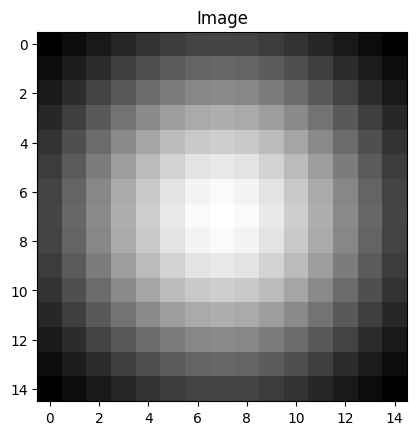

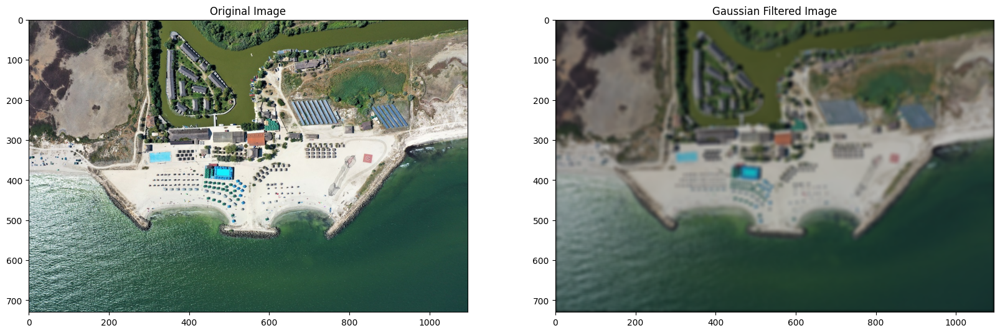

In [ ]:
def gaussian_filter(sigma, filter_size):
  v = np.linspace(-(filter_size - 1)/2, (filter_size - 1)/2, filter_size)
  x, y = np.meshgrid(v, v)
  return np.exp(-((np.square(x) + np.square(y))/(2.0 * sigma**2)))/(2.0*np.pi*sigma**2)

gfilter = gaussian_filter(5, 15)
gaussian_filtererd_image = apply_filter(input_image, gfilter)

print("Input image shape = ", input_image.shape)
print("Filtered image shape = ", gaussian_filtererd_image.shape)

plt.imshow(gfilter, interpolation='none', cmap='gray')
plt.title("Image")
plt.show()

plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(input_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(gaussian_filtererd_image.astype('uint8'))
plt.title('Gaussian Filtered Image')

plt.show()

# Box filter

Input image shape =  (730, 1095, 3)
Filtered image shape =  (730, 1095, 3)


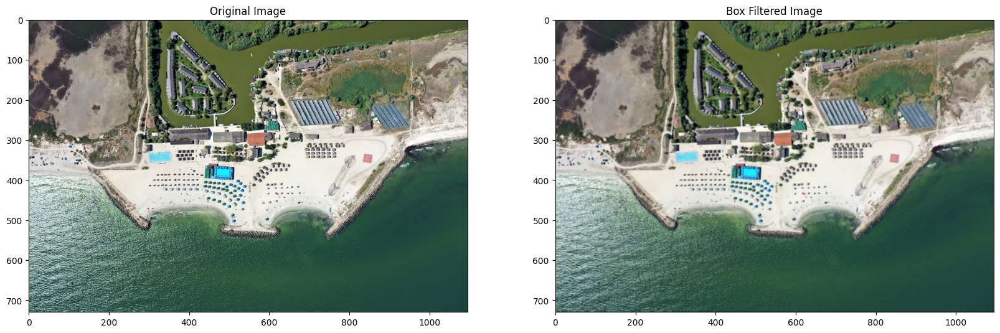

In [ ]:
def box_filter(filter_size):
    return np.ones((filter_size, filter_size)) / filter_size**2

bfilter = box_filter(3)
box_filtered_image = apply_filter(input_image, bfilter)

print("Input image shape = ", input_image.shape)
print("Filtered image shape = ", gaussian_filtererd_image.shape)


plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(input_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(box_filtered_image.astype('uint8'))
plt.title('Box Filtered Image')

plt.show()

# Grayscale

Input image shape =  (730, 1095, 3)
Filtered image shape =  (730, 1095, 3)


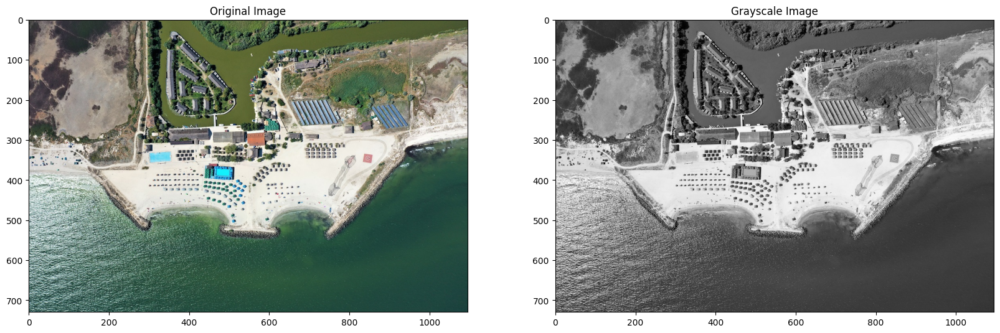

In [ ]:
def grayscale(image):
    gray = np.dot(image[..., :3], [0.2989, 0.5870, 0.1140])
    return np.stack((gray, gray, gray), axis=-1)


grayscale_image = grayscale(input_image)

print("Input image shape = ", input_image.shape)
print("Filtered image shape = ", grayscale_image.shape)
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(input_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(grayscale_image.astype('uint8'))
plt.title('Grayscale Image')
plt.show()

# Sobel filter

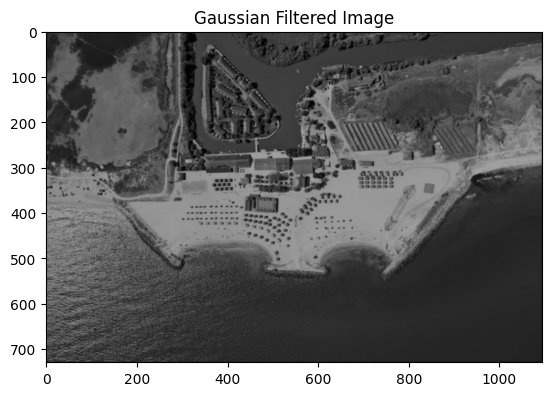

Input image shape =  (730, 1095, 3)
Filtered image shape =  (730, 1095, 3)


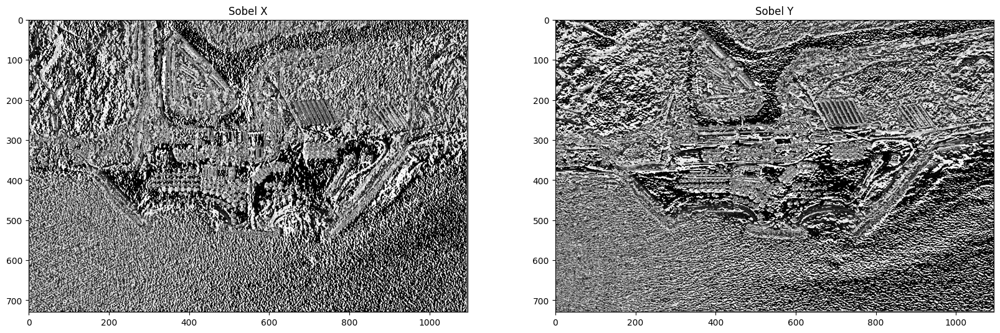

In [ ]:
grayscale_image = grayscale(input_image)

# Gaussian filter
gfilter = gaussian_filter(1.2, 3)
gaussian_filtered_image = apply_filter(grayscale_image, gfilter)

plt.title('Gaussian Filtered Image')
plt.imshow(gaussian_filtered_image.astype('uint8'))
plt.show()

sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
sobel_y = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]], np.float32)
sobel_image_x = apply_filter(gaussian_filtered_image, sobel_x)
sobel_image_y = apply_filter(gaussian_filtered_image, sobel_y)

print("Input image shape = ", input_image.shape)
print("Filtered image shape = ", sobel_image_x.shape)
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(sobel_image_x.astype('uint8'))
plt.title('Sobel X')

plt.subplot(1, 2, 2)
plt.imshow(sobel_image_y.astype('uint8'))
plt.title('Sobel Y')
plt.show()

# Sobel Gradient of Input Image

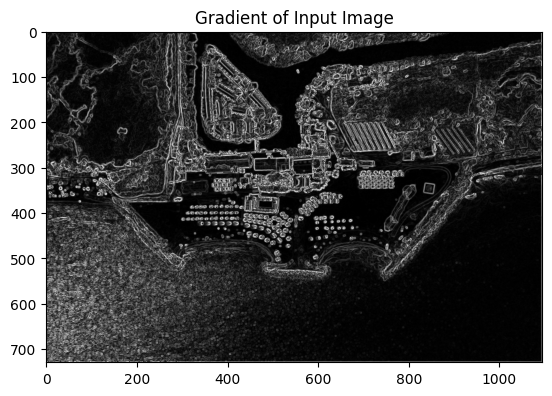

In [ ]:
gradient = np.hypot(sobel_image_x, sobel_image_y)
theta = np.arctan2(sobel_image_x, sobel_image_y)

plt.title('Gradient of Input Image')
plt.imshow(gradient.astype('uint8'))
plt.show()

# Prewitt filter

Input image shape =  (730, 1095, 3)
Filtered image shape =  (730, 1095, 3)


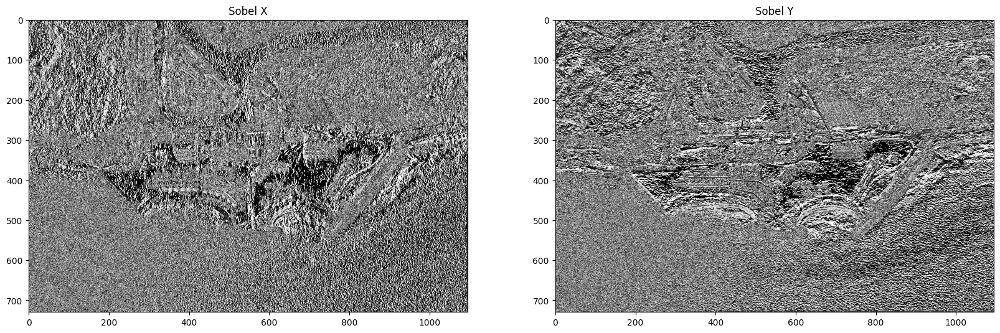

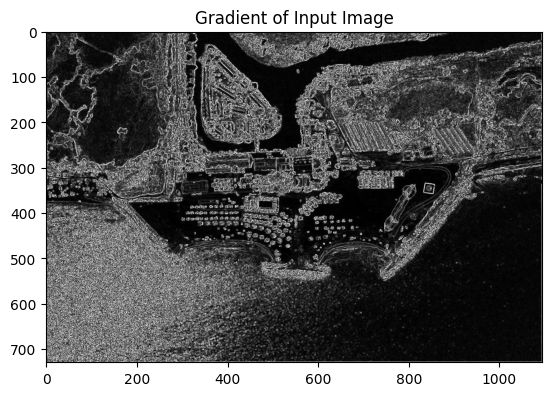

In [ ]:
grayscale_image = grayscale(input_image)

prewitt_x = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])
prewitt_y = np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]])

prewitt_image_x = apply_filter(grayscale_image, prewitt_x)
prewitt_image_y = apply_filter(grayscale_image, prewitt_y)

print("Input image shape = ", input_image.shape)
print("Filtered image shape = ", prewitt_image_x.shape)
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(prewitt_image_x.astype('uint8'))
plt.title('Sobel X')

plt.subplot(1, 2, 2)
plt.imshow(prewitt_image_y.astype('uint8'))
plt.title('Sobel Y')
plt.show()

gradient = np.hypot(prewitt_image_x, prewitt_image_y)
theta = np.arctan2(prewitt_image_x, prewitt_image_y)

plt.title('Gradient of Input Image')
plt.imshow(gradient.astype('uint8'))
plt.show()

# Laplacian filter

Input image shape =  (730, 1095, 3)
Filtered image shape =  (730, 1095, 3)


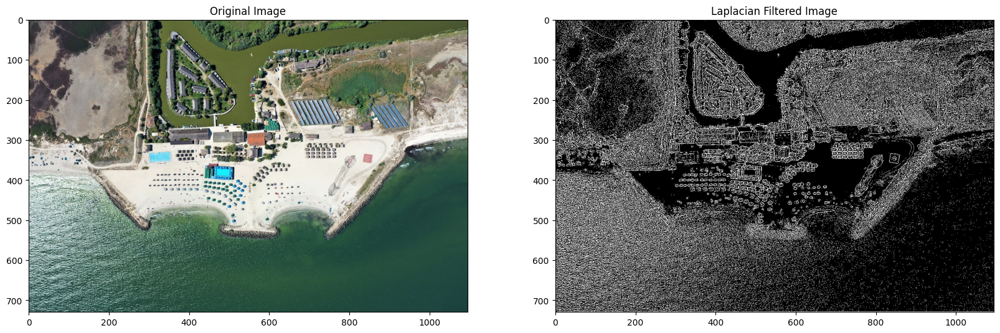

In [ ]:
def laplacian_filter(image):
  grayscale_image = grayscale(image)
  lfilter = np.array([[-1, -1, -1], [-1, 8, -1], [-1, -1, -1]])
  filtered_image = apply_filter(grayscale_image, lfilter)
  filtered_image = np.uint8(filtered_image > 50) * 255
  return filtered_image

laplacian_filtered_image = laplacian_filter(input_image)
print("Input image shape = ", input_image.shape)
print("Filtered image shape = ", laplacian_filtered_image.shape)

plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(input_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(laplacian_filtered_image.astype('uint8'))
plt.title('Laplacian Filtered Image')

plt.show()

# Canny Filter

Input image shape =  (730, 1095, 3)
Filtered image shape =  (730, 1095, 3)


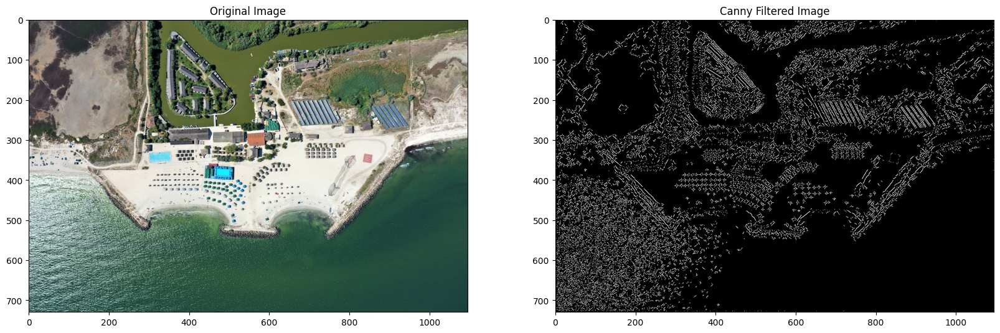

In [ ]:
def canny_filter(image):
    row_image, col_image = image.shape[0], image.shape[1]

    # Grayscale
    grayscale_image = grayscale(image)

    # Gaussian filter
    gfilter = gaussian_filter(1.2, 9)
    gaussian_filtered_image = apply_filter(grayscale_image, gfilter)

    # Sobel filter
    sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
    sobel_y = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]], np.float32)
    sobel_image_x = apply_filter(gaussian_filtered_image, sobel_x)
    sobel_image_y = apply_filter(gaussian_filtered_image, sobel_y)

    # Calculate gradient of the image
    gradient = np.hypot(sobel_image_x, sobel_image_y)
    theta = np.arctan2(sobel_image_x, sobel_image_y)
    angle = theta * 180. / np.pi
    angle[angle < 0] += 180

    # Non-maximum suppression
    surpressed_image = np.zeros((row_image, col_image, 3), dtype=np.float32)
    for i in range(1, row_image - 1):
        for j in range(1, col_image - 1):
            l, r = 255, 255

            if (0 <= angle[i, j][0] < 22.5) or (157.5 <= angle[i, j][0] <= 180):
                l = gradient[i, j - 1]
                r = gradient[i, j + 1]

            elif 22.5 <= angle[i, j][0] < 67.5:
                l = gradient[i + 1, j - 1]
                r = gradient[i - 1, j + 1]

            elif 67.5 <= angle[i, j][0] < 112.5:
                l = gradient[i - 1, j]
                r = gradient[i + 1, j]

            elif 112.5 <= angle[i, j][0] < 157.5:
                l = gradient[i - 1, j - 1]
                r = gradient[i + 1, j + 1]

            if (gradient[i, j][0] >= l[0]) and (gradient[i, j][0] >= r[0]):
                surpressed_image[i, j] = gradient[i, j]
            else:
                surpressed_image[i, j] = 0

    # Double threshold
    double_threshold_image = np.zeros((row_image, col_image, 3), dtype=np.float32)
    hi_thresh = surpressed_image.max()*0.17
    lo_thresh = hi_thresh * 0.09
    strong_i, strong_j = np.where(surpressed_image[:, :, 0] >= hi_thresh)
    weak_i, weak_j = np.where((surpressed_image[:, :, 0] >= lo_thresh) & (surpressed_image[:, :, 0] <= hi_thresh))
    double_threshold_image[strong_i, strong_j] = [255, 255, 255]
    double_threshold_image[weak_i, weak_j] = [127, 127, 127]

    # Hysteresis
    for i in range(1, row_image - 1):
        for j in range(1, col_image - 1):
            if double_threshold_image[i, j][0] == 127:
                if (
                        (double_threshold_image[i + 1, j - 1][0] == 255) or (double_threshold_image[i + 1, j][0] == 255) or
                        (double_threshold_image[i + 1, j + 1][0] == 255) or (double_threshold_image[i, j - 1][0] == 255) or
                        (double_threshold_image[i, j + 1][0] == 255) or (double_threshold_image[i - 1, j - 1][0] == 255) or
                        (double_threshold_image[i - 1, j][0] == 255) or (double_threshold_image[i - 1, j + 1][0] == 255)
                ):
                    double_threshold_image[i, j] = [255, 255, 255]
                else:
                    double_threshold_image[i, j] = [0, 0, 0]
    return double_threshold_image


canny_filtered_image = canny_filter(input_image)
print("Input image shape = ", input_image.shape)
print("Filtered image shape = ", canny_filtered_image.shape)

plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(input_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(canny_filtered_image.astype('uint8'))
plt.title('Canny Filtered Image')

plt.show()

# Pool detection

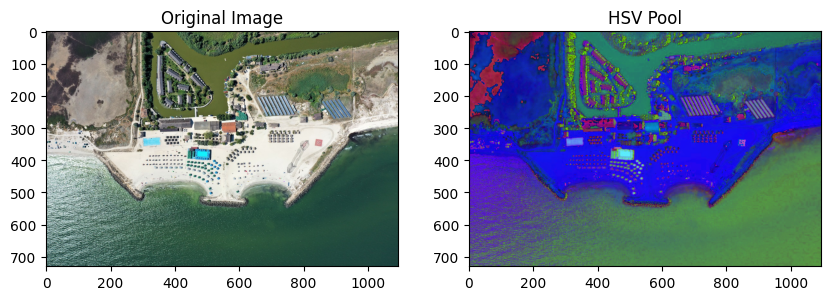

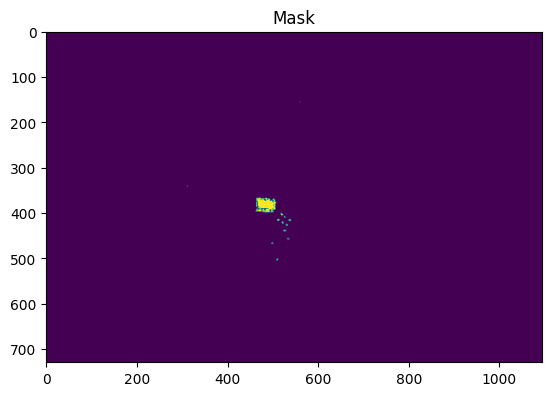

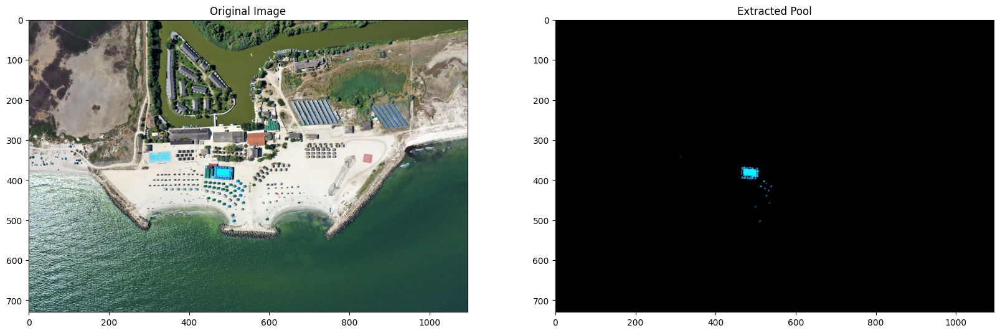

In [ ]:
input_image = cv2.imread('Gura_Portitei_Scara_020.jpg')
rgb_image = cv2.cvtColor(input_image, code=cv2.COLOR_BGR2RGB)
hsv_image = cv2.cvtColor(rgb_image, cv2.COLOR_RGB2HSV)
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(rgb_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(hsv_image.astype('uint8'))
plt.title('HSV Pool')

plt.show()

# lower_blue = np.array([17, 241, 247])
# upper_blue = np.array([28, 242, 250])

lower_blue = np.array([80, 170, 170])
upper_blue = np.array([130, 255, 255])


# lower = np.zeros((100, 100, 3), dtype=np.uint8)
# lower[:, :] = cv2.cvtColor(np.uint8([[lower_blue]]), cv2.COLOR_HSV2BGR)[0][0]

# upper = np.zeros((100, 100, 3), dtype=np.uint8)
# upper[:, :] = cv2.cvtColor(np.uint8([[upper_blue]]), cv2.COLOR_HSV2BGR)[0][0]

# plt.figure(figsize=(5, 5))
# plt.subplot(1, 2, 1)
# plt.imshow(cv2.cvtColor(lower, cv2.COLOR_HSV2RGB).astype('uint8'))
# plt.title('Lower')

# plt.subplot(1, 2, 2)
# plt.imshow(cv2.cvtColor(upper, cv2.COLOR_HSV2RGB).astype('uint8'))
# plt.title('Upper')
# plt.show()


# Create a binary mask for the blue pool region
mask = cv2.inRange(hsv_image, lower_blue, upper_blue)

plt.imshow(mask.astype('uint8'))
plt.title('Mask')

plt.show()

pool = cv2.bitwise_and(rgb_image, rgb_image, mask=mask)

plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(rgb_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(pool.astype('uint8'))
plt.title('Extracted Pool')

plt.show()


# Orange Building Detection

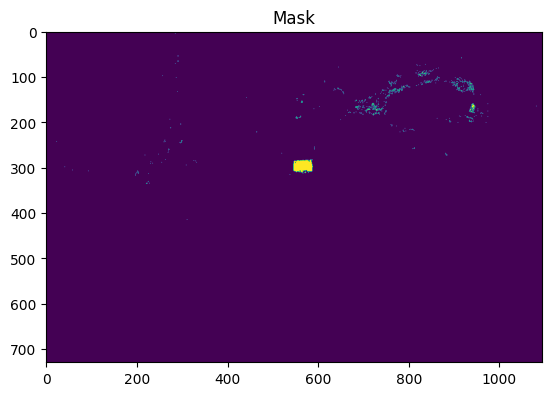

Text(0.5, 1.0, 'Extracted Orange Building')

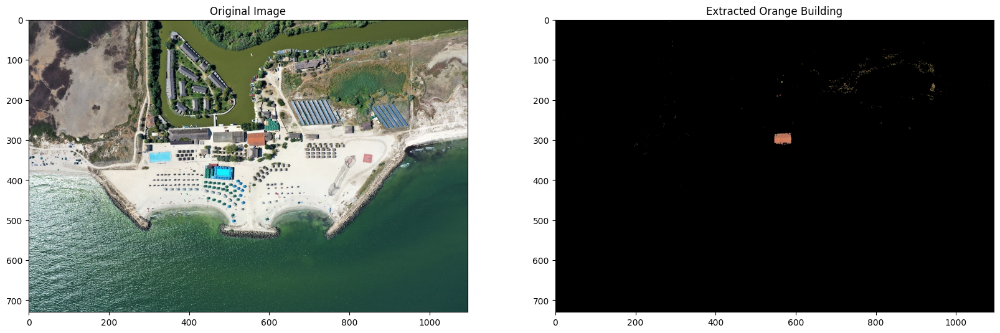

In [ ]:
input_image = cv2.imread('Gura_Portitei_Scara_020.jpg')
rgb_image = cv2.cvtColor(input_image, code=cv2.COLOR_BGR2RGB)
hsv_image = cv2.cvtColor(rgb_image, cv2.COLOR_RGB2HSV)

lower_orange = np.array([5, 100, 100])
upper_orange = np.array([25, 255, 255])

orange_mask = cv2.inRange(hsv_image, lower_orange, upper_orange)

plt.imshow(orange_mask.astype('uint8'))
plt.title('Mask')
plt.show()

dark_orange_house = cv2.bitwise_and(rgb_image, rgb_image, mask=orange_mask)

plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(rgb_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(dark_orange_house.astype('uint8'))
plt.title('Extracted Orange Building')



# Landing Site Detection

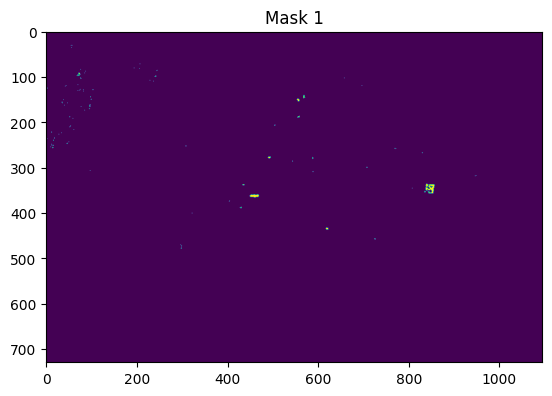

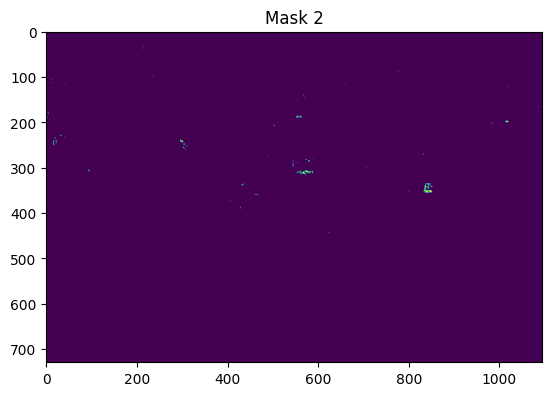

Text(0.5, 1.0, 'Extracted Orange Building')

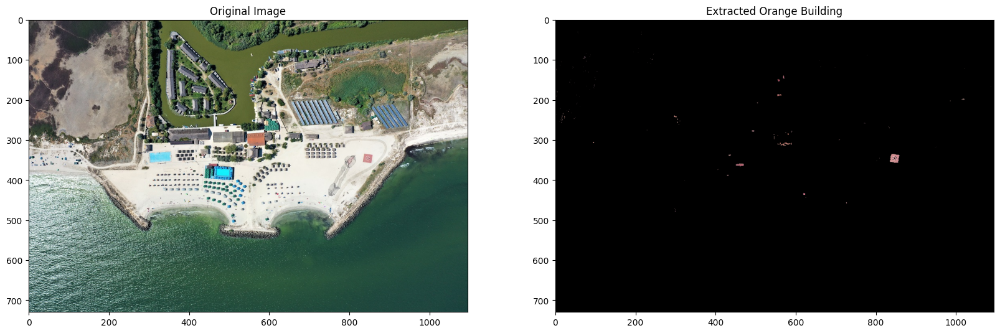

In [ ]:
input_image = cv2.imread('Gura_Portitei_Scara_020.jpg')
rgb_image = cv2.cvtColor(input_image, code=cv2.COLOR_BGR2RGB)
hsv_image = cv2.cvtColor(rgb_image, cv2.COLOR_RGB2HSV)

lower_red1 = np.array([160, 50, 50])
upper_red1 = np.array([179, 255, 255])

lower_red2 = np.array([0, 50, 100])
upper_red2 = np.array([5, 255, 255])

red_mask1 = cv2.inRange(hsv_image, lower_red1, upper_red1)
red_mask2 = cv2.inRange(hsv_image, lower_red2, upper_red2)

combined_mask = cv2.bitwise_or(red_mask1, red_mask2)


plt.imshow(red_mask1.astype('uint8'))
plt.title('Mask 1')
plt.show()

plt.imshow(red_mask2.astype('uint8'))
plt.title('Mask 2')
plt.show()

landing_site = cv2.bitwise_and(rgb_image, rgb_image, mask=combined_mask)

plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(rgb_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(landing_site.astype('uint8'))
plt.title('Extracted Orange Building')


Input image shape =  (220, 220, 3)
Filtered image shape =  (220, 220, 3)


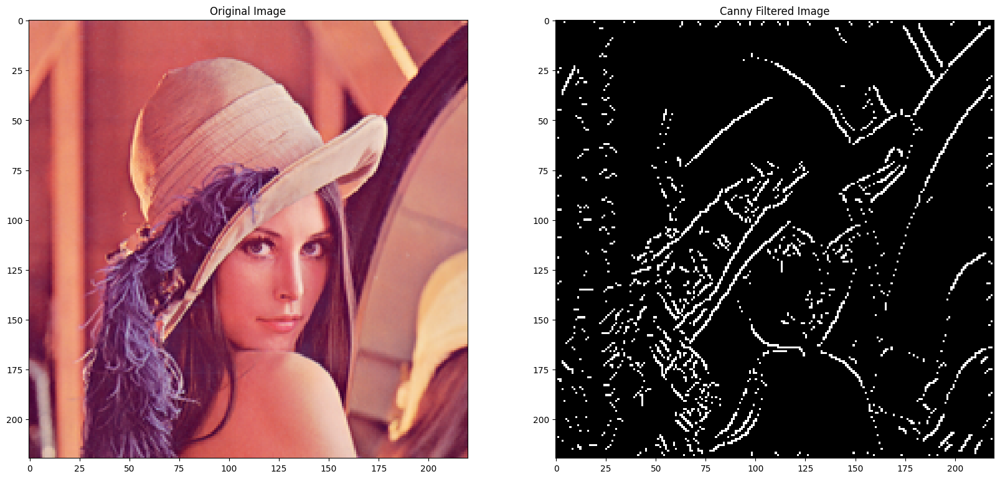

In [ ]:
input_image = cv2.imread('Lenna_(test_image).png')
input_image = cv2.cvtColor(src=input_image, code=cv2.COLOR_BGR2RGB)

canny_filtered_image = canny_filter(input_image)
print("Input image shape = ", input_image.shape)
print("Filtered image shape = ", canny_filtered_image.shape)

plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(input_image.astype('uint8'))
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(canny_filtered_image.astype('uint8'))
plt.title('Canny Filtered Image')

plt.show()

Input image shape =  (730, 1095, 3)
Filtered image shape =  (730, 1095, 3)


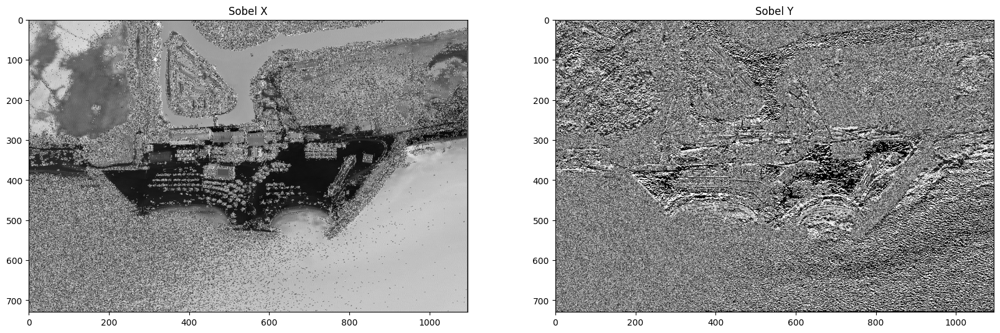

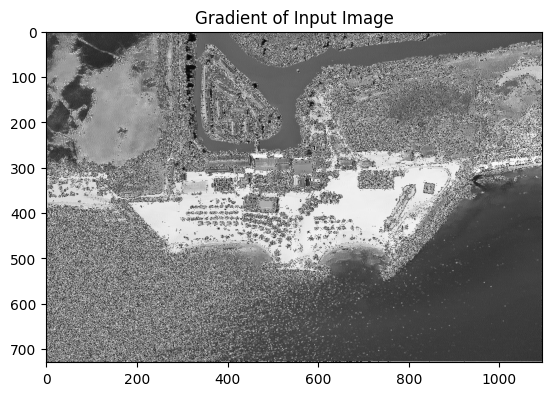

In [ ]:
grayscale_image = grayscale(input_image)

custom_sobel_x = np.array([[0, 0, 0],
                          [-2, 3, -2],
                          [0, 0, 0]])

custom_sobel_y = np.array([[-1, -2, -1],
                          [0, 0, 0],
                          [1, 2, 1]])

prewitt_image_x = apply_filter(grayscale_image, custom_sobel_x)
prewitt_image_y = apply_filter(grayscale_image, custom_sobel_y)

print("Input image shape = ", input_image.shape)
print("Filtered image shape = ", prewitt_image_x.shape)
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(prewitt_image_x.astype('uint8'))
plt.title('Sobel X')

plt.subplot(1, 2, 2)
plt.imshow(prewitt_image_y.astype('uint8'))
plt.title('Sobel Y')
plt.show()

gradient = np.hypot(prewitt_image_x, prewitt_image_y)
theta = np.arctan2(prewitt_image_x, prewitt_image_y)

plt.title('Gradient of Input Image')
plt.imshow(gradient.astype('uint8'))
plt.show()

# Comparison

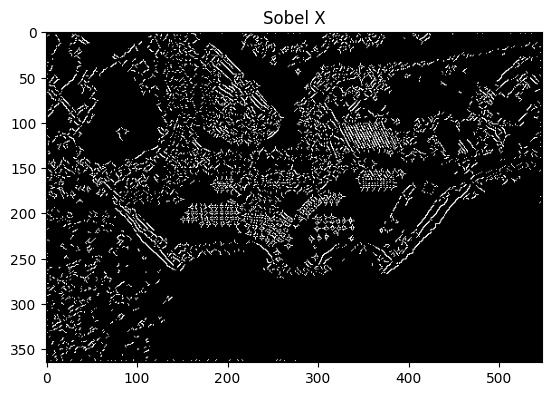

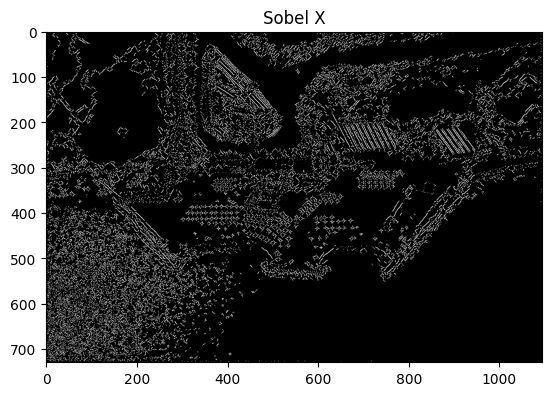

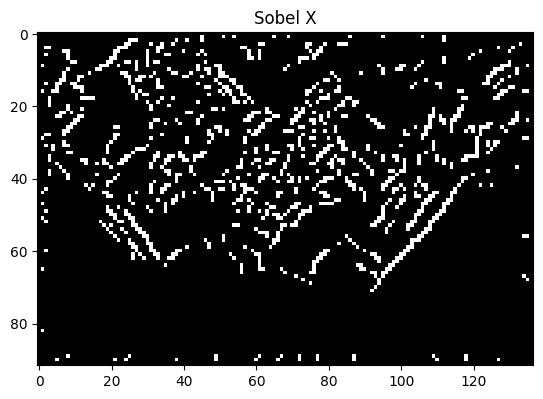

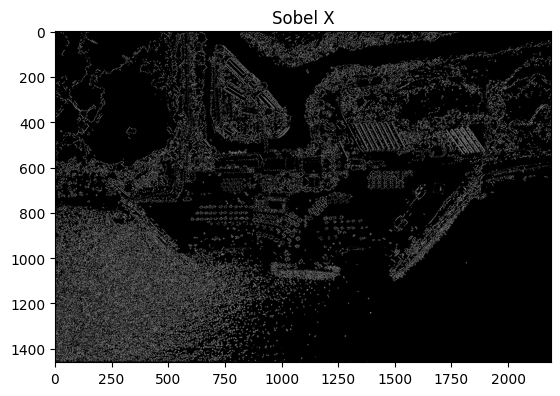

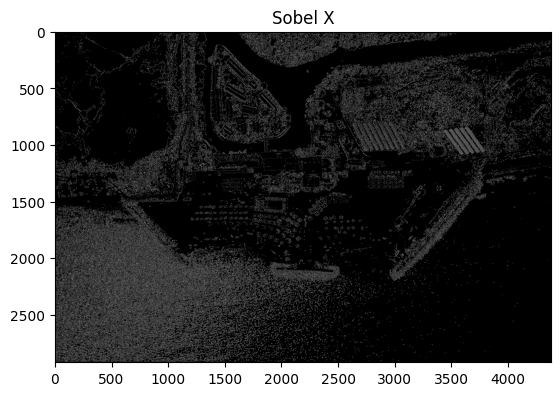

In [22]:
def sobel(image):
  grayscale_image = grayscale(input_image)
  gfilter = gaussian_filter(1.2, 5)
  gaussian_filtered_image = apply_filter(grayscale_image, gfilter)

  sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
  sobel_y = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]], np.float32)
  sobel_image_x = apply_filter(gaussian_filtered_image, sobel_x)
  sobel_image_y = apply_filter(gaussian_filtered_image, sobel_y)
  gradient = np.hypot(sobel_image_x, sobel_image_y)
  theta = np.arctan2(sobel_image_x, sobel_image_y)
  return gradient, theta


input_image_010 = cv2.imread('Gura_Portitei_Scara_010.jpg')
input_image_020 = cv2.imread('Gura_Portitei_Scara_020.jpg')
input_image_025 = cv2.imread('Gura_Portitei_Scara_0025.jpg')
input_image_040 = cv2.imread('Gura_Portitei_Scara_040.jpg')
input_image_080 = cv2.imread('Gura_Portitei_Scara_080.jpg')

input_image_010 = cv2.cvtColor(src=input_image_010, code=cv2.COLOR_BGR2RGB)
input_image_020 = cv2.cvtColor(src=input_image_020, code=cv2.COLOR_BGR2RGB)
input_image_025 = cv2.cvtColor(src=input_image_025, code=cv2.COLOR_BGR2RGB)
input_image_040 = cv2.cvtColor(src=input_image_040, code=cv2.COLOR_BGR2RGB)
input_image_080 = cv2.cvtColor(src=input_image_080, code=cv2.COLOR_BGR2RGB)

gradient_image_010 = canny_filter(input_image_010)
gradient_image_020 = canny_filter(input_image_020)
gradient_image_025 = canny_filter(input_image_025)
gradient_image_040 = canny_filter(input_image_040)
gradient_image_080 = canny_filter(input_image_080)

plt.imshow(gradient_image_010.astype('uint8'))
plt.title('Sobel X')
plt.show()

plt.imshow(gradient_image_020.astype('uint8'))
plt.title('Sobel X')
plt.show()

plt.imshow(gradient_image_025.astype('uint8'))
plt.title('Sobel X')
plt.show()

plt.imshow(gradient_image_040.astype('uint8'))
plt.title('Sobel X')
plt.show()

plt.imshow(gradient_image_080.astype('uint8'))
plt.title('Sobel X')
plt.show()